<a href="https://colab.research.google.com/github/namphuongtran9196/Car_Clasification/blob/main/Build_R_CNN_(Object_detection).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Prepare dataset**

###**About car dataset**
**Overview**

  The Cars dataset contains 16,185 images of 196 classes of cars. The data is split into 8,144 training images and 8,041 testing images, where each class has been split roughly in a 50-50 split. Classes are typically at the level of Make, Model, Year, e.g. 2012 Tesla Model S or 2012 BMW M3 coupe.

**Citation**
3D Object Representations for Fine-Grained Categorization
       Jonathan Krause, Michael Stark, Jia Deng, Li Fei-Fei
       4th IEEE Workshop on 3D Representation and Recognition, at ICCV 2013 (3dRR-13). Sydney, Australia. Dec. 8, 2013.

In [9]:
!wget http://imagenet.stanford.edu/internal/car196/cars_train.tgz
!gunzip cars_train.tgz

--2021-04-07 08:11:49--  http://imagenet.stanford.edu/internal/car196/cars_train.tgz
Resolving imagenet.stanford.edu (imagenet.stanford.edu)... 171.64.68.16
Connecting to imagenet.stanford.edu (imagenet.stanford.edu)|171.64.68.16|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 979269282 (934M) [application/x-gzip]
Saving to: ‘cars_train.tgz’

cars_train.tgz        2%[                    ]  23.35M  6.61MB/s    eta 4m 49s ^C

gzip: cars_train.tgz: unexpected end of file


In [10]:
!tar -xf cars_train.tar
!rm cars_train.tar

tar: cars_train.tar: Cannot open: No such file or directory
tar: Error is not recoverable: exiting now
rm: cannot remove 'cars_train.tar': No such file or directory


In [11]:
!wget http://imagenet.stanford.edu/internal/car196/cars_test.tgz
!gunzip cars_test.tgz

--2021-04-07 08:11:56--  http://imagenet.stanford.edu/internal/car196/cars_test.tgz
Resolving imagenet.stanford.edu (imagenet.stanford.edu)... 171.64.68.16
Connecting to imagenet.stanford.edu (imagenet.stanford.edu)|171.64.68.16|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 977350468 (932M) [application/x-gzip]
Saving to: ‘cars_test.tgz’

cars_test.tgz         0%[                    ] 960.78K   537KB/s               ^C

gzip: cars_test.tgz: unexpected end of file


In [12]:
!tar -xf cars_test.tar
!rm cars_test.tar

tar: cars_test.tar: Cannot open: No such file or directory
tar: Error is not recoverable: exiting now
rm: cannot remove 'cars_test.tar': No such file or directory


In [13]:
!wget https://ai.stanford.edu/~jkrause/cars/car_devkit.tgz
!gunzip car_devkit.tgz

--2021-04-07 08:11:58--  https://ai.stanford.edu/~jkrause/cars/car_devkit.tgz
Resolving ai.stanford.edu (ai.stanford.edu)... 171.64.68.10
Connecting to ai.stanford.edu (ai.stanford.edu)|171.64.68.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 330960 (323K) [application/x-gzip]
Saving to: ‘car_devkit.tgz’

car_devkit.tgz      100%[===================>] 323.20K   550KB/s    in 0.6s    

2021-04-07 08:11:59 (550 KB/s) - ‘car_devkit.tgz’ saved [330960/330960]



In [14]:
!tar -xf car_devkit.tar
!rm car_devkit.tar

### **Plot some image in dataset**

In [15]:
import os, random
image_list = []
list_file = os.listdir('cars_train/')
for i in range(10):
    filepath = 'cars_train/'+ random.choice(list_file)
    image_list.append(filepath)

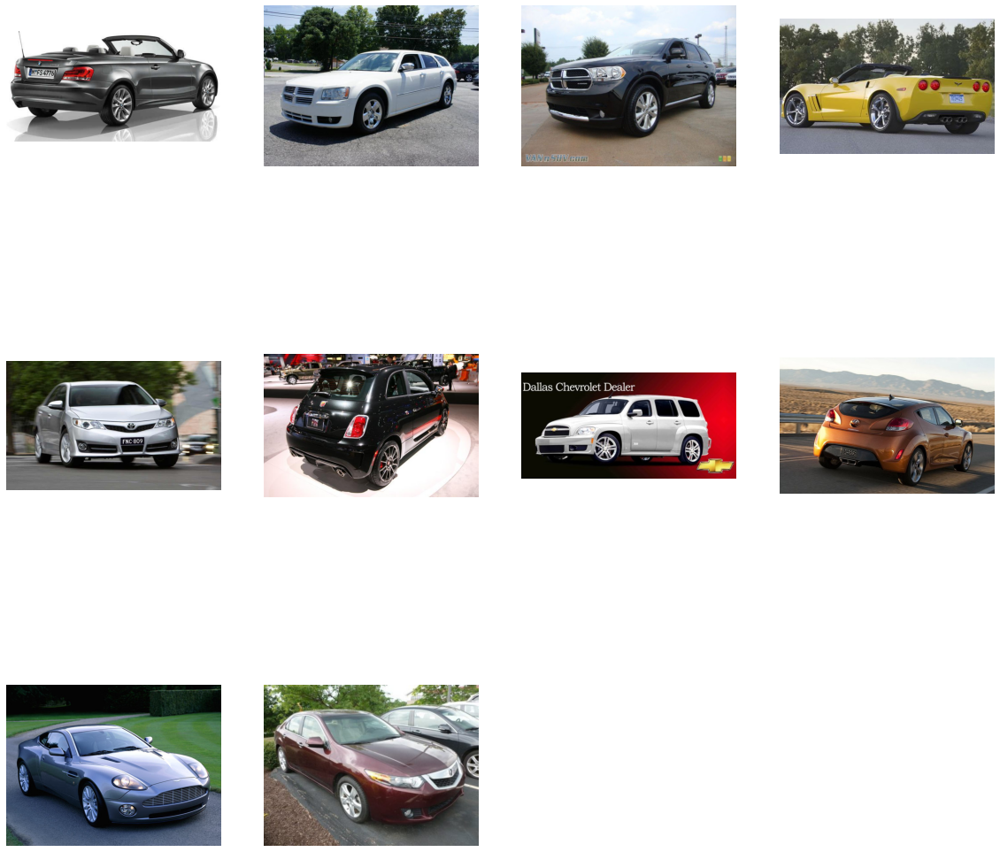

In [16]:
import matplotlib.pyplot as plt
import cv2
plt.subplots(figsize=(20,20))
k = 1
for image in image_list:
    im = cv2.imread(image)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    plt.subplot(3,4,k)
    plt.imshow(im)
    plt.axis("off")
    k += 1

# **Selective search**

Selective Search is a region proposal algorithm for object detection tasks. It starts by over-segmenting the image based on intensity of the pixels using a graph-based segmentation method by Felzenszwalb and Huttenlocher. Selective Search then takes these oversegments as initial input and performs the following steps

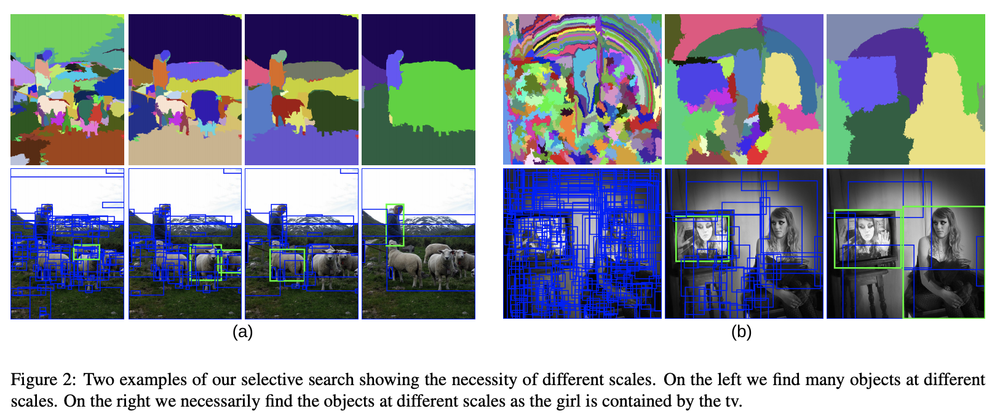

### In this model, I use the selective search which is implemented by cv2

In [17]:
import os,cv2,keras
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from matplotlib.patches import Rectangle

In [18]:
ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

In [19]:
image = 'cars_train/00001.jpg'
img = cv2.imread(image)
ss.setBaseImage(img)
ss.switchToSelectiveSearchFast()
ssresults = ss.process()
print(ssresults.shape)

(2016, 4)


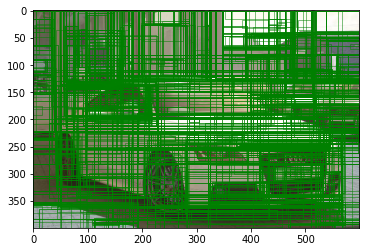

In [20]:
img = cv2.imread(image)
fig, ax = plt.subplots()
ax.imshow(img)
for i in range(ssresults.shape[0]):
    x,y,w,h = ssresults[i]
    ax.add_patch(Rectangle((x,y),w,h,linewidth=0.5, edgecolor='g',facecolor='none'))   
plt.show()

# **Intersection Over Union (IoU)**
Intersection over Union is an evaluation metric used to measure the accuracy of an object detector on a particular dataset. Any algorithm that provides predicted bounding boxes as output can be evaluated using IoU

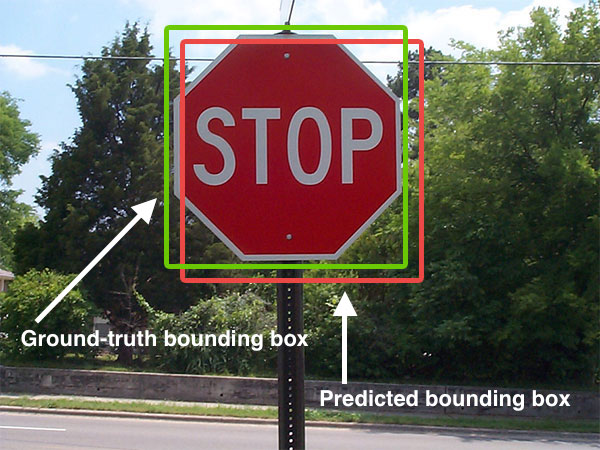
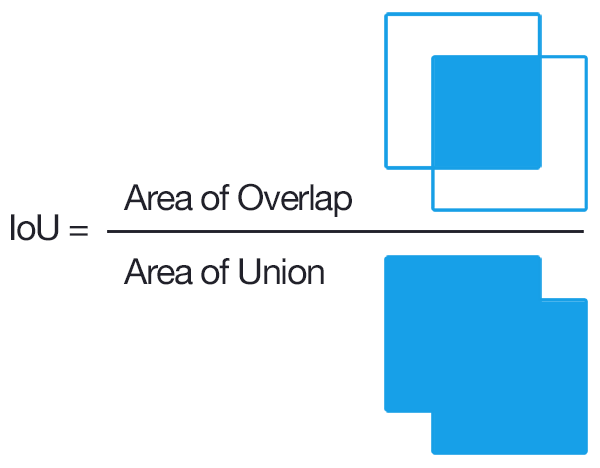
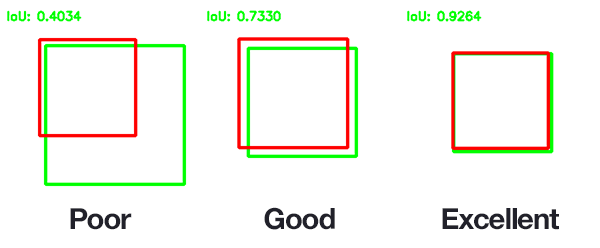

For more information about Intersection over Union
https://www.pyimagesearch.com/2016/11/07/intersection-over-union-iou-for-object-detection/

The code in this link has some errors, if you want to use it, make sure you had fixed it.

In [21]:
# import the necessary packages
from collections import namedtuple
import numpy as np
import cv2
# define the `Detection` object
ex = namedtuple("ex", ["image_path", "gt", "pred"])

In [22]:
def get_IoU(bb_true, bb_pred):
    # determine the (x, y)-coordinates of the intersection rectangle
    # the input of bb_true and bb_pred is [x1,y1,x2,y2] where x1<x2, y1<y2
    x_min = max(bb_true[0], bb_pred[0])
    y_min = max(bb_true[1], bb_pred[1])

    x_max = min(bb_true[2], bb_pred[2])
    y_max = min(bb_true[3], bb_pred[3])

    # check if it does not have intersection rectangle
    if x_max < x_min or y_max< y_min:
        return 0.0
    # compute the area of intersection rectangle
    interArea = (x_max - x_min + 1) * (y_max - y_min + 1)

    # compute the union area
    bbTrueArea = (bb_true[2] - bb_true[0] + 1) * (bb_true[3] - bb_true[1] + 1)
    bbPredArea = (bb_pred[2] - bb_pred[0] + 1) * (bb_pred[3] - bb_pred[1] + 1)

    unionArea = bbTrueArea + bbPredArea - interArea
    # areas - the interesection area
    iou = interArea / unionArea
    # return the intersection over union value
    return iou

In [23]:
examples = [
	ex(image, [39 ,116 ,569 ,375], [10, 95, 135 ,131]),
	ex(image, [39 ,116 ,569 ,375], [69 ,136 ,469 ,675]),
	ex(image, [39 ,116 ,569 ,375], [39 ,22, 23, 32]),
	ex(image, [39 ,116 ,569 ,375], [39 ,116 ,569 ,375])]

cars_train/00001.jpg: 0.0110


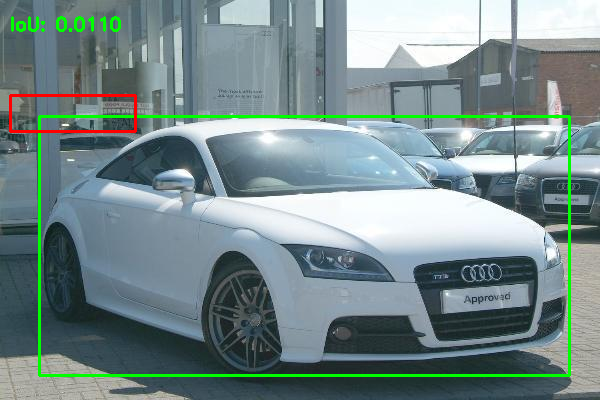

cars_train/00001.jpg: 0.3725


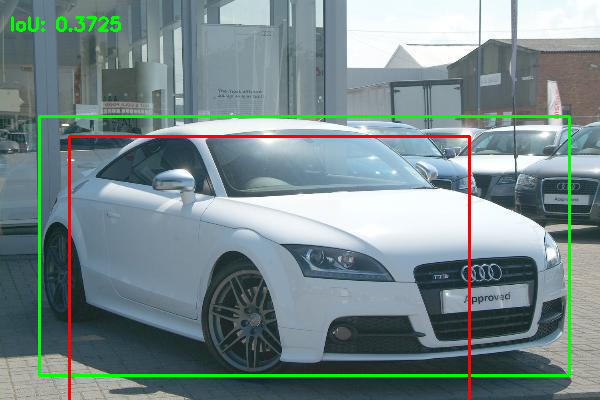

cars_train/00001.jpg: 0.0000


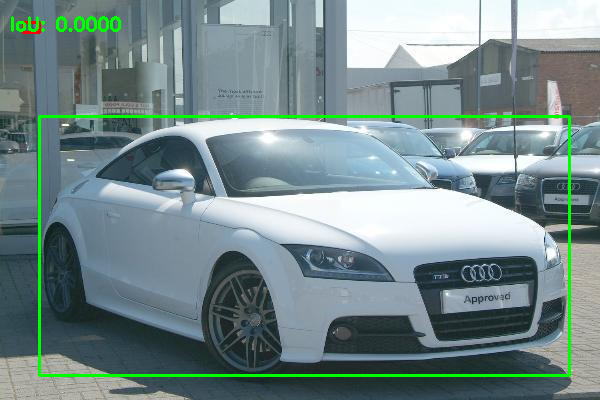

cars_train/00001.jpg: 1.0000


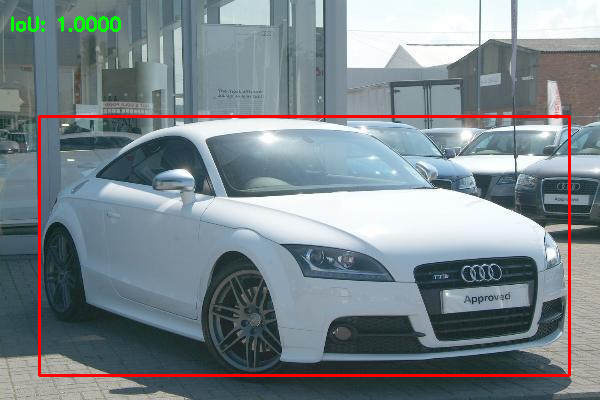

In [24]:
from google.colab.patches import cv2_imshow
# loop over the example
for ex in examples:
    # load the image
    img = cv2.imread(image)
    # draw the ground-truth bounding box along with the predicted
    # bounding box
    cv2.rectangle(img, tuple(ex.gt[:2]), 
      tuple(ex.gt[2:]), (0, 255, 0), 2)
    cv2.rectangle(img, tuple(ex.pred[:2]), 
      tuple(ex.pred[2:]), (0, 0, 255), 2)
    # compute the intersection over union and display it
    iou = get_IoU(ex.gt, ex.pred)
    cv2.putText(img, "IoU: {:.4f}".format(iou), (10, 30),
      cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)
    print("{}: {:.4f}".format(ex.image_path, iou))
    # show the output image
    cv2_imshow(img)
    cv2.waitKey(0)

***An Intersection over Union score > 0.5 is normally considered a “good” prediction. ***

# **Use IoU for classification which is an object and which is a background**


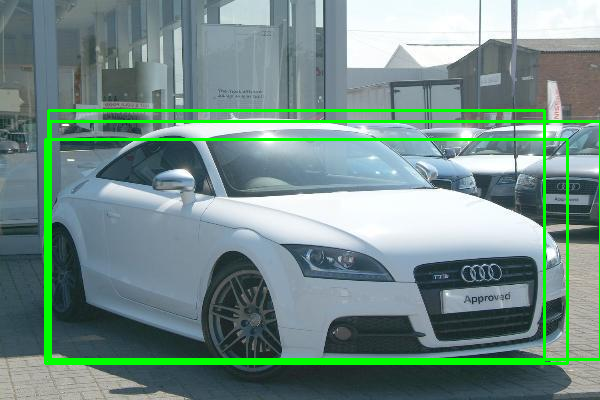

In [25]:
from google.colab.patches import cv2_imshow
# loop over the example detections
# draw the ground-truth bounding box along with the predicted
# bounding box
img = cv2.imread(image)
for i in range(ssresults.shape[0]):
    x,y,w,h = ssresults[i]
    if(get_IoU([39 ,116 ,569 ,375],[x,y,x+w,y+h]) >= 0.85):
          cv2.rectangle(img, (x,y), (x+w,y+h), (0, 255, 0), 2)
# show the output image
cv2_imshow(img)

# **Build R-CNN for car detection**


### Import libary

In [26]:
import os,cv2,keras
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import scipy.io

### Read .mat file and get the bounding box 

In [27]:
mat = scipy.io.loadmat('devkit/cars_train_annos.mat')
mat.items()

dict_items([('__header__', b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Sat Dec 14 14:13:07 2013'), ('__version__', '1.0'), ('__globals__', []), ('annotations', array([[(array([[39]], dtype=uint8), array([[116]], dtype=uint8), array([[569]], dtype=uint16), array([[375]], dtype=uint16), array([[14]], dtype=uint8), array(['00001.jpg'], dtype='<U9')),
        (array([[36]], dtype=uint8), array([[116]], dtype=uint8), array([[868]], dtype=uint16), array([[587]], dtype=uint16), array([[3]], dtype=uint8), array(['00002.jpg'], dtype='<U9')),
        (array([[85]], dtype=uint8), array([[109]], dtype=uint8), array([[601]], dtype=uint16), array([[381]], dtype=uint16), array([[91]], dtype=uint8), array(['00003.jpg'], dtype='<U9')),
        ...,
        (array([[26]], dtype=uint8), array([[246]], dtype=uint8), array([[660]], dtype=uint16), array([[449]], dtype=uint16), array([[163]], dtype=uint8), array(['08142.jpg'], dtype='<U9')),
        (array([[78]], dtype=uint8), array([[526]], dtype

In [28]:
mat['annotations']

array([[(array([[39]], dtype=uint8), array([[116]], dtype=uint8), array([[569]], dtype=uint16), array([[375]], dtype=uint16), array([[14]], dtype=uint8), array(['00001.jpg'], dtype='<U9')),
        (array([[36]], dtype=uint8), array([[116]], dtype=uint8), array([[868]], dtype=uint16), array([[587]], dtype=uint16), array([[3]], dtype=uint8), array(['00002.jpg'], dtype='<U9')),
        (array([[85]], dtype=uint8), array([[109]], dtype=uint8), array([[601]], dtype=uint16), array([[381]], dtype=uint16), array([[91]], dtype=uint8), array(['00003.jpg'], dtype='<U9')),
        ...,
        (array([[26]], dtype=uint8), array([[246]], dtype=uint8), array([[660]], dtype=uint16), array([[449]], dtype=uint16), array([[163]], dtype=uint8), array(['08142.jpg'], dtype='<U9')),
        (array([[78]], dtype=uint8), array([[526]], dtype=uint16), array([[1489]], dtype=uint16), array([[908]], dtype=uint16), array([[112]], dtype=uint8), array(['08143.jpg'], dtype='<U9')),
        (array([[20]], dtype=uint8

### Create cv2 selective search, prepare data train

In [29]:
ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

In [30]:
def get_IoU(bb_true, bb_pred):
    assert bb_true[0]<bb_true[2]
    assert bb_true[1]<bb_true[3]
    assert bb_pred[0]<bb_pred[2]
    assert bb_pred[1]<bb_pred[3]
    # determine the (x, y)-coordinates of the intersection rectangle
    x_min = max(bb_true[0], bb_pred[0])
    y_min = max(bb_true[1], bb_pred[1])

    x_max = min(bb_true[2], bb_pred[2])
    y_max = min(bb_true[3], bb_pred[3])
    # check if it does not have intersection rectangle
    if x_max < x_min or y_max< y_min:
        return 0.0
    # compute the area of intersection rectangle
    interArea = (x_max - x_min + 1) * (y_max - y_min + 1)
    # compute the union area
    bbTrueArea = (bb_true[2] - bb_true[0] + 1) * (bb_true[3] - bb_true[1] + 1)
    bbPredArea = (bb_pred[2] - bb_pred[0] + 1) * (bb_pred[3] - bb_pred[1] + 1)
    unionArea = float(bbTrueArea + bbPredArea - interArea)
    # areas - the interesection area
    iou = interArea / unionArea
    # return the intersection over union value
    assert iou <= 1.0
    return iou

### Plot some bouding box in cars dataset

[39, 116, 569, 375]


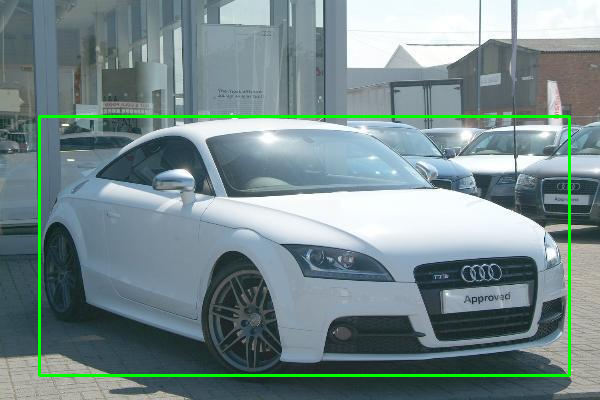

[36, 116, 868, 587]


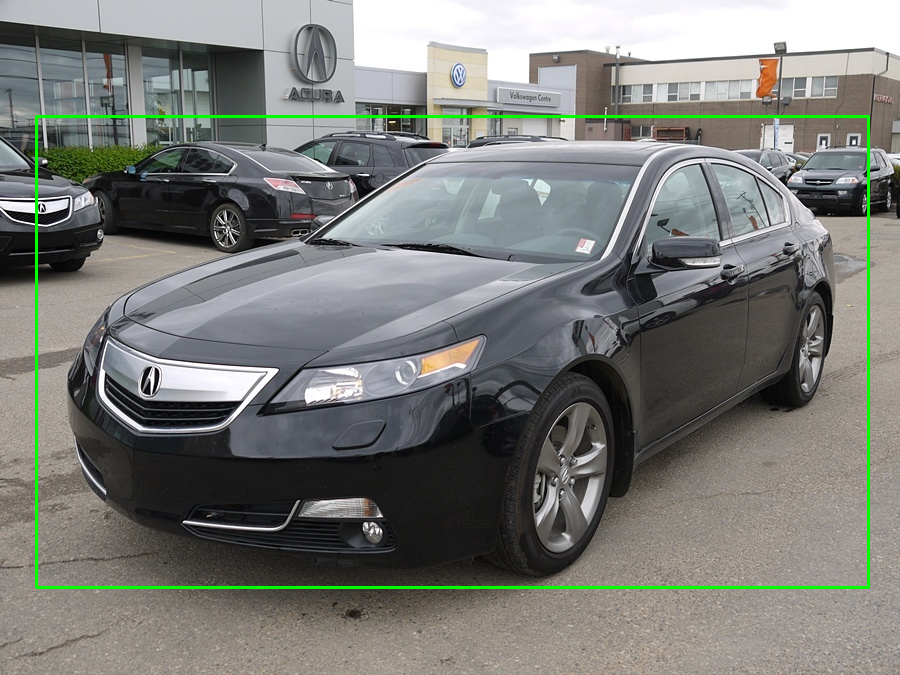

[85, 109, 601, 381]


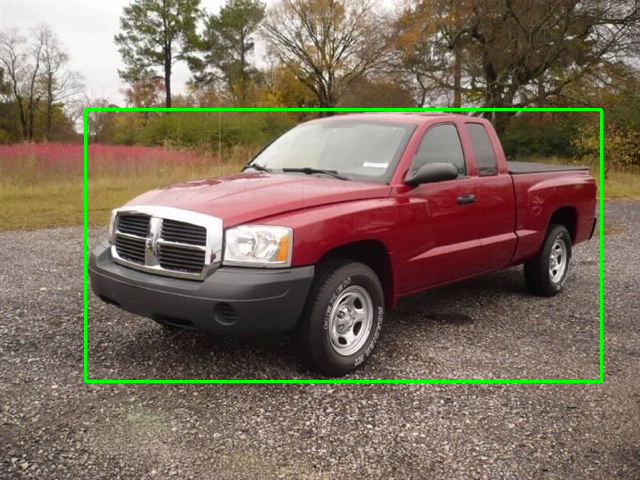

[621, 393, 1484, 1096]


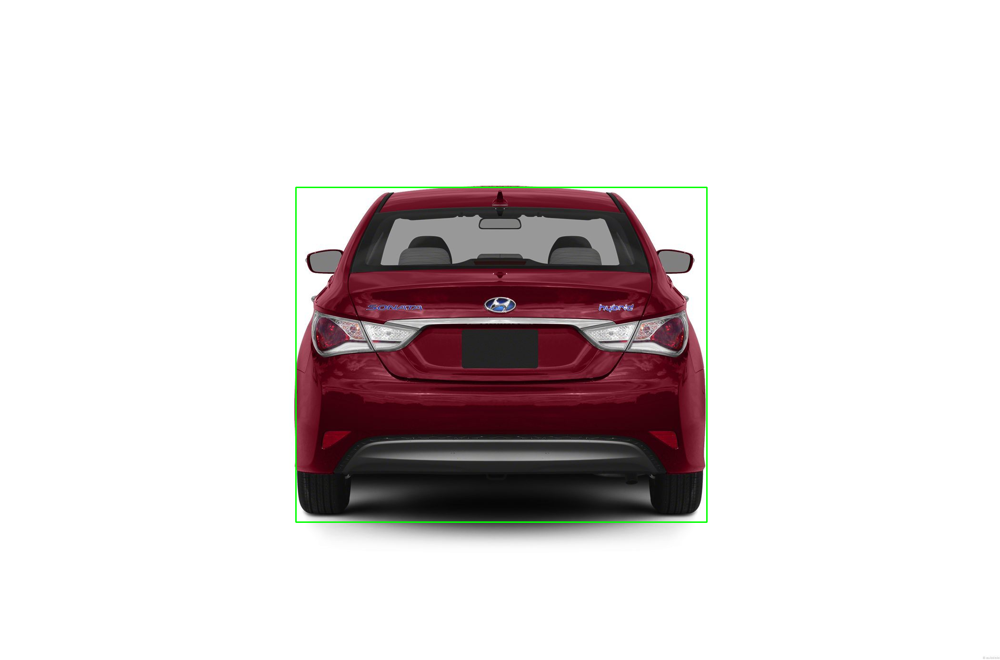

[14, 36, 133, 99]


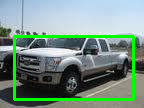

[259, 289, 515, 416]


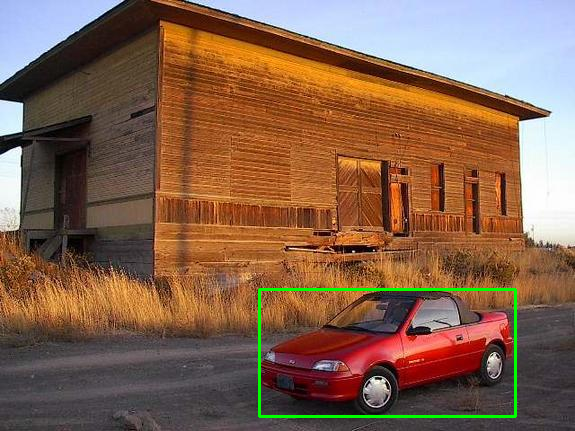

[88, 80, 541, 397]


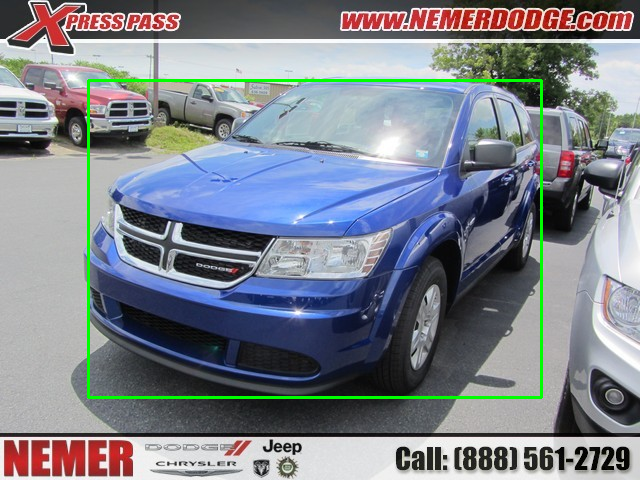

[73, 79, 591, 410]


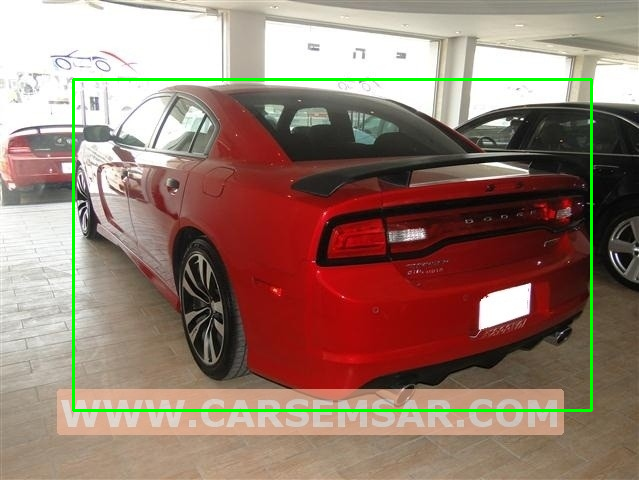

[20, 126, 1269, 771]


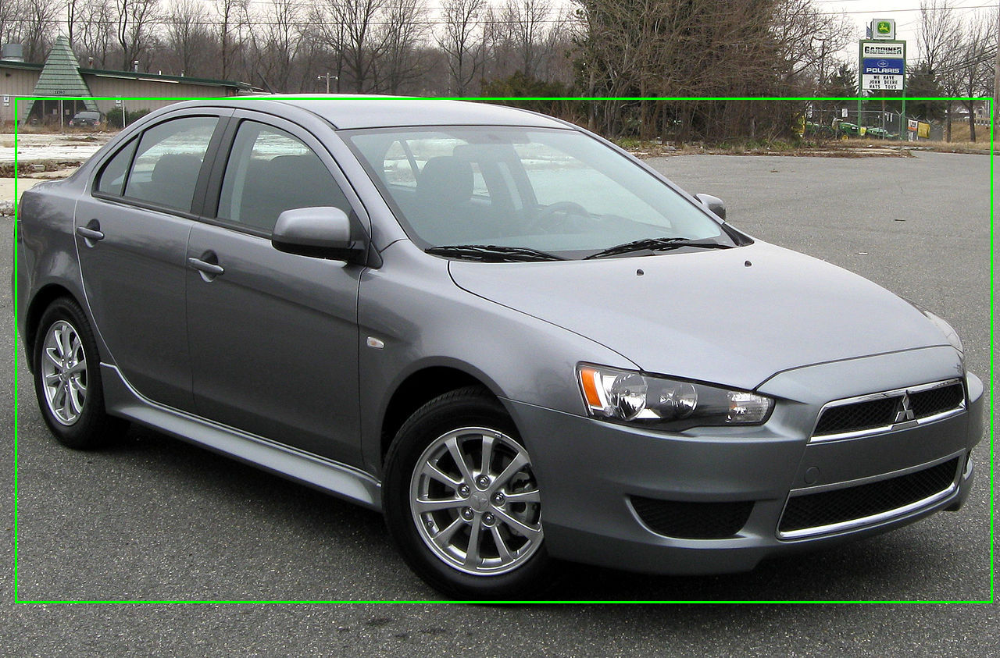

[21, 110, 623, 367]


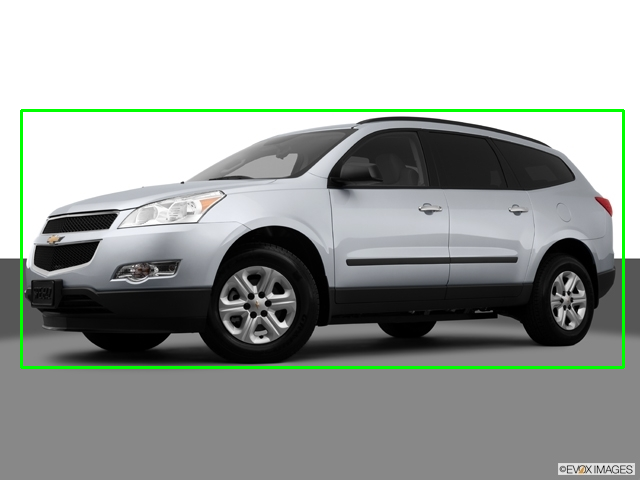

[51, 93, 601, 393]


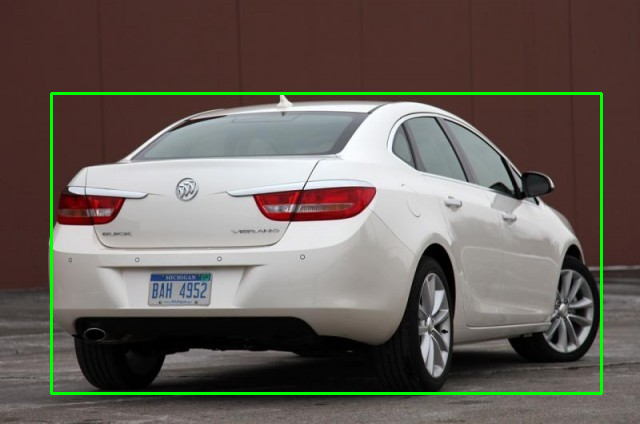

[6, 62, 499, 286]


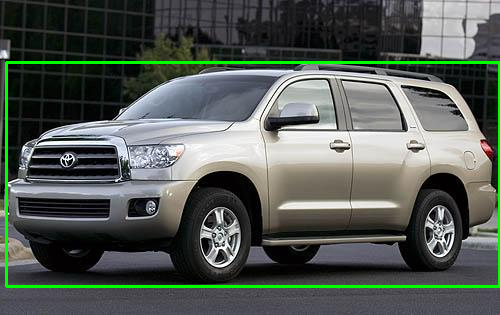

In [31]:
import sys
from tqdm import tqdm

train_Data =np.sort(np.array(os.listdir('cars_train')))
bbox_x1,bbox_y1 = mat['annotations']['bbox_x1'],mat['annotations']['bbox_y1']
bbox_x2,bbox_y2 = mat['annotations']['bbox_x2'],mat['annotations']['bbox_y2']
# with tqdm(total=50, file=sys.stdout) as pbar:
for i,filename in enumerate(train_Data):
    file_path = 'cars_train/' + filename
    img = cv2.imread(file_path)
    bbox_true = [int(bbox_x1[0,i]),int(bbox_y1[0,i]),int(bbox_x2[0,i]),int(bbox_y2[0,i])]
    print(bbox_true)
    cv2.rectangle(img, (bbox_true[0],bbox_true[1]), (bbox_true[2], bbox_true[3]), (0, 255, 0), 2)
    cv2_imshow(img)
    if i>10:
          break

### Create data train

In [32]:
train_images = []
train_labels = []
train_Data =np.sort(np.array(os.listdir('cars_train')))
bbox_x1,bbox_y1 = mat['annotations']['bbox_x1'],mat['annotations']['bbox_y1']
bbox_x2,bbox_y2 = mat['annotations']['bbox_x2'],mat['annotations']['bbox_y2']

import sys
from tqdm import tqdm
with tqdm(total=200, file=sys.stdout) as pbar:
  for i,filename in enumerate(train_Data):
      file_path = 'cars_train/' + filename
      img = cv2.imread(file_path)
      bbox_true = [int(bbox_x1[0,i]),int(bbox_y1[0,i]),int(bbox_x2[0,i]),int(bbox_y2[0,i])]
      ss.setBaseImage(img)
      ss.switchToSelectiveSearchFast()
      ssresults = ss.process()
      temp_img = img.copy()
      true_counter = 0
      false_counter = 0
      for j,result in enumerate(ssresults):
          if j>1000:
              break
          x,y,w,h = result
          iou = get_IoU(bbox_true,[x,y,x+w,y+h])
          if true_counter <=5 and iou >= 0.85:
              img_train = temp_img[y:y+h,x:x+w]
              resized = cv2.resize(img_train,(224,224))
              train_images.append(resized)
              train_labels.append(1)
              true_counter+=1
          elif false_counter<=5 and iou<=0.7:
              img_train = temp_img[y:y+h,x:x+w]
              resized = cv2.resize(img_train,(224,224))
              train_images.append(resized)
              train_labels.append(0)
              false_counter+=1
          if true_counter > 5 and false_counter >5:
              break
      pbar.update(1)
      if i>200:
            break
      

202it [1:13:14, 21.76s/it]


In [33]:
train_x = np.array(train_images)
train_y = np.array(train_labels)

### Plot some crop image and labels in data train

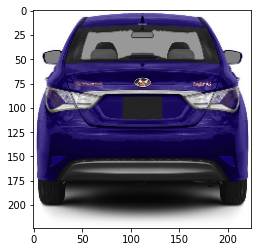

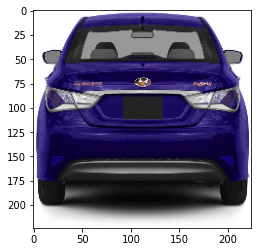

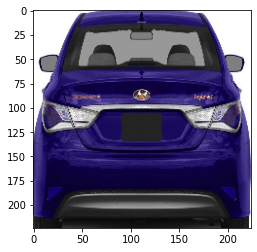

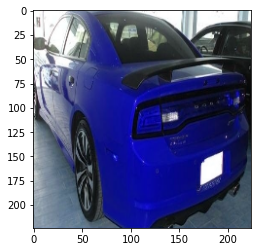

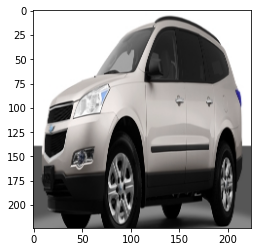

...

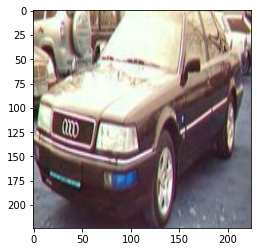

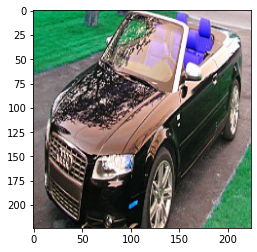

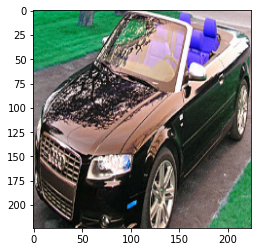

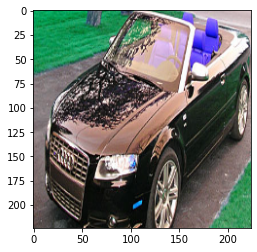

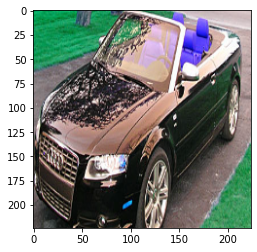

194


In [34]:
from PIL import Image
count=0
for i,image in enumerate(train_x):
    if train_y[i] == 1:
      count+=1
      img = Image.fromarray(image,'RGB')
      plt.imshow(img)
      plt.show()
print(count)

In [35]:
from keras.layers import Dense
from keras import Model
from keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.applications.vgg16 import VGG16

BATCH_SIZE = 128
EPOCHS = 8

In [36]:
from sklearn.model_selection import train_test_split
y_ohe = tf.keras.utils.to_categorical(train_y, num_classes=2)
x_train, x_valid, y_train_ohe, y_valid_ohe = train_test_split(train_x, y_ohe, test_size=0.2)

In [37]:
train_datagen = ImageDataGenerator(horizontal_flip = True, vertical_flip= True, rotation_range = 90)
train_data = train_datagen.flow(x = x_train, y = y_train_ohe,batch_size=BATCH_SIZE)

### Create VGG16 model, and tranning with adam optimizer

In [38]:
vgg16 = VGG16(input_shape=(224,224,3),weights = 'imagenet', include_top=False)

for layers in vgg16.layers:
    layers.trainable = False

x = tf.keras.layers.Flatten()(vgg16.output)
x = tf.keras.layers.Dense(units=4096,activation="relu")(x)
x = tf.keras.layers.Dense(units=4096,activation="relu")(x)
predictions = tf.keras.layers.Dense(units=2, activation = 'softmax')(x)

model = Model(inputs = vgg16.input, outputs = predictions)
mcp = tf.keras.callbacks.ModelCheckpoint("my_model.h5", monitor="val_accuracy",
                      save_best_only=True, save_weights_only=True)
model.compile(Adam(0.001), loss='categorical_crossentropy',
                  metrics=['accuracy'])
model.fit_generator(generator = train_data, epochs= EPOCHS,
              validation_data=(x_valid, y_valid_ohe), verbose=1, callbacks=[mcp])


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/8
9/9 [==============================] - 650s 73s/step - loss: 245.9090 - accuracy: 0.6509 - val_loss: 0.2197 - val_accuracy: 0.9716
Epoch 2/8
9/9 [==============================] - 645s 73s/step - loss: 0.1380 - accuracy: 0.9813 - val_loss: 0.0820 - val_accuracy: 0.9787
Epoch 3/8
9/9 [==============================] - 643s 73s/step - loss: 0.0633 - accuracy: 0.9864 - val_loss: 0.0758 - val_accuracy: 0.9645
Epoch 4/8
9/9 [==============================] - 642s 73s/step - loss: 0.0373 - accuracy: 0.9850 - val_loss: 0.1895 - val_accuracy: 0.9468
Epoch 5/8
9/9 [==============================] - 649s 74s/step - loss: 0.0442 - accuracy: 0.9846 - val_loss: 0.1546 - val_accuracy: 0.9787
Epoch 6/8
9/9 [==============================] - 643s 74s/step - loss: 0.0188 - accuracy: 0.9951 - val_loss: 0.1246 - val_accuracy: 0.9787
Epoch 7/8
9/9 [==============================] - 641s 74s/step - loss: 0.0237 - accuracy: 0.9931 - val_loss: 0.1537 - val_accuracy: 0.9823
Epoch 8/8
9/9 [==========

### Use model to predict the bounding box of the car in the image

In [39]:
device = '/cpu:0' if len(tf.config.experimental.list_physical_devices('GPU')) == 0 else '/gpu:0'
with tf.device(device):
    model.load_weights("my_model.h5")

cars_train/04842.jpg
 77%|███████▋  | 769/1000 [06:53<02:04,  1.86it/s]
cars_train/03143.jpg
 75%|███████▍  | 747/1000 [06:41<02:16,  1.86it/s]
cars_train/02635.jpg
8451it [09:00, 15.63it/s]                          
cars_train/03275.jpg
 93%|█████████▎| 930/1000 [08:21<00:37,  1.85it/s]
cars_train/02526.jpg
1412it [08:58,  2.62it/s]                          
cars_train/03748.jpg
5427it [09:01, 10.02it/s]                          
cars_train/08133.jpg
3172it [09:00,  5.87it/s]                          
cars_train/04186.jpg
2536it [08:58,  4.71it/s]                          
cars_train/03486.jpg
3153it [09:00,  5.84it/s]                          
cars_train/07000.jpg
 78%|███████▊  | 776/1000 [07:00<02:01,  1.85it/s]


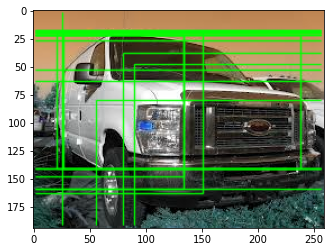

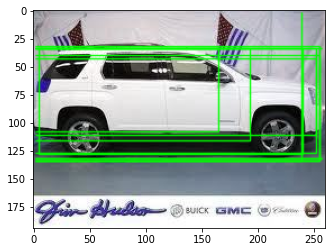

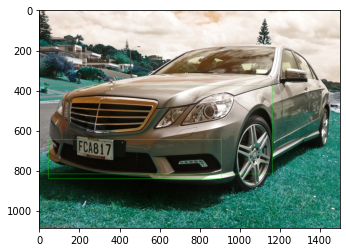

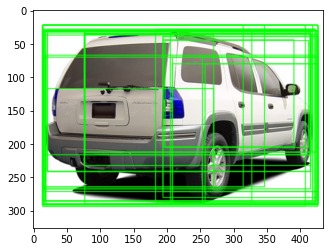

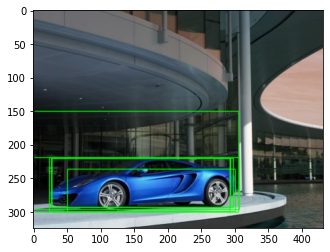

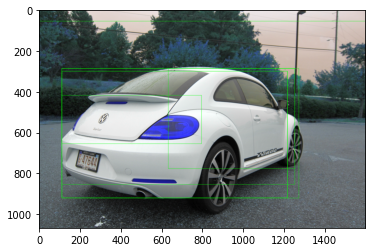

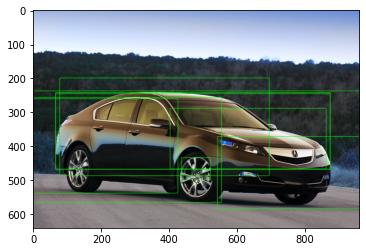

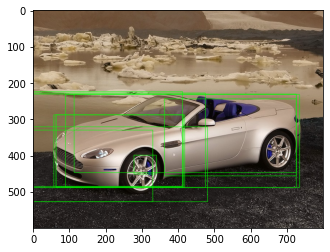

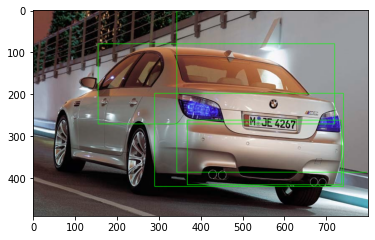

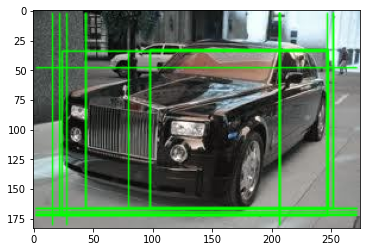

In [40]:
import sys
from tqdm import tqdm
for i in range(10):
  image_test = 'cars_train/'+ random.choice(list_file)
  print(image_test)
  ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
  img = cv2.imread(image_test)
  ss.setBaseImage(img)
  ss.switchToSelectiveSearchFast()
  ssresults = ss.process()
  img_temp = img.copy()
  with tqdm(total=1000, file=sys.stdout) as pbar:
      for i, results in enumerate(ssresults):
          if i<1000:
              x,y,w,h = results
              img_predict = img_temp[y:y+h, x:x+w]
              resized = cv2.resize(img_predict,(224,224))
              resized = np.expand_dims(resized, axis=0)
              predictions = model.predict(resized)
              if (predictions[0][1] >= 0.5):
                  cv2.rectangle(img_temp,(x,y),(x+w,y+h),(0,255,0),1,cv2.LINE_AA)
          pbar.update(1)
  plt.figure()
  plt.imshow(img_temp)

# Authors: Tran Phuong Nam

Facebook: https://www.facebook.com/namphuongtran9196/

Github: https://github.com/namphuongtran9196

Linkedln: https://www.linkedin.com/in/namtranphuong9196/